# Demonstration

This Jupyter Notebook aims to walk you through the process of training this model on a custom dataset. For the sake of this demo, we will use a public image segmentation dataset ([CHAOS](https://chaos.grand-challenge.org/Data/) \[1\]). Although the dataset is composed of 40 total CT and MRI scans, we will use only the 20 CT scans with liver ground-truth segmentation. We will train a U-Net style \[2\] network trained on 2D maximum intensity projections of ground-truth 3D annotations following the work of  Mateusz Kozinski et. al 2018 \[3\].

# Data

## Downloading data

Please refer to https://chaos.grand-challenge.org/Download/ for more details on the terms of use for this dataset.

In [ ]:
!wget https://zenodo.org/record/3431873/files/CHAOS_Test_Sets.zip

--2020-08-09 16:17:35--  https://zenodo.org/record/3431873/files/CHAOS_Test_Sets.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.184.117.155
Connecting to zenodo.org (zenodo.org)|188.184.117.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1091803676 (1.0G) [application/octet-stream]
Saving to: ‘CHAOS_Test_Sets.zip?download=1’

CHAOS_Test_Sets.zip 100%[===================>]   1.02G  11.7MB/s    in 96s     

2020-08-09 16:19:12 (10.8 MB/s) - ‘CHAOS_Test_Sets.zip?download=1’ saved [1091803676/1091803676]



In [ ]:
!wget https://zenodo.org/record/3431873/files/CHAOS_Train_Sets.zip

--2020-08-09 16:19:13--  https://zenodo.org/record/3431873/files/CHAOS_Train_Sets.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.184.117.155
Connecting to zenodo.org (zenodo.org)|188.184.117.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 890771694 (850M) [application/octet-stream]
Saving to: ‘CHAOS_Train_Sets.zip?download=1’

CHAOS_Train_Sets.zi 100%[===================>] 849.51M  12.6MB/s    in 63s     

2020-08-09 16:20:17 (13.6 MB/s) - ‘CHAOS_Train_Sets.zip?download=1’ saved [890771694/890771694]



In [ ]:
!unzip /content/CHAOS_Test_Sets.zip
!unzip /content/CHAOS_Train_Sets.zip

Streaming output truncated to the last 5000 lines.
  inflating: Train_Sets/CT/28/Ground/liver_GT_060.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_061.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_062.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_063.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_064.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_065.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_066.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_067.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_068.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_069.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_070.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_071.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_072.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_073.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_074.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_075.png  
  inflating: Train_Sets/CT/28/Ground/liver_GT_076.png

In [ ]:
!pip install dicom

     |████████████████████████████████| 768kB 5.7MB/s 


## Reading data

In [ ]:
import numpy as np

In [ ]:
import os 
import dicom
from skimage import io

ct_dir = '/content/Train_Sets/CT'
ct_img_files = [os.path.join(ct_dir, p, 'DICOM_anon') for p in os.listdir(ct_dir)]
ct_seg_files = [os.path.join(ct_dir, p, 'Ground') for p in os.listdir(ct_dir)]
list(zip(ct_img_files, ct_seg_files))

/usr/local/lib/python3.6/dist-packages/dicom/__init__.py:53: UserWarning: 
This code is using an older version of pydicom, which is no longer 
maintained as of Jan 2017.  You can access the new pydicom features and API 
by installing `pydicom` from PyPI.
See 'Transitioning to pydicom 1.x' section at pydicom.readthedocs.org 
for more information.

  warnings.warn(msg)


[('/content/Train_Sets/CT/24/DICOM_anon', '/content/Train_Sets/CT/24/Ground'),
 ('/content/Train_Sets/CT/30/DICOM_anon', '/content/Train_Sets/CT/30/Ground'),
 ('/content/Train_Sets/CT/5/DICOM_anon', '/content/Train_Sets/CT/5/Ground'),
 ('/content/Train_Sets/CT/8/DICOM_anon', '/content/Train_Sets/CT/8/Ground'),
 ('/content/Train_Sets/CT/23/DICOM_anon', '/content/Train_Sets/CT/23/Ground'),
 ('/content/Train_Sets/CT/16/DICOM_anon', '/content/Train_Sets/CT/16/Ground'),
 ('/content/Train_Sets/CT/1/DICOM_anon', '/content/Train_Sets/CT/1/Ground'),
 ('/content/Train_Sets/CT/25/DICOM_anon', '/content/Train_Sets/CT/25/Ground'),
 ('/content/Train_Sets/CT/6/DICOM_anon', '/content/Train_Sets/CT/6/Ground'),
 ('/content/Train_Sets/CT/2/DICOM_anon', '/content/Train_Sets/CT/2/Ground'),
 ('/content/Train_Sets/CT/26/DICOM_anon', '/content/Train_Sets/CT/26/Ground'),
 ('/content/Train_Sets/CT/28/DICOM_anon', '/content/Train_Sets/CT/28/Ground'),
 ('/content/Train_Sets/CT/21/DICOM_anon', '/content/Train_Sets

In [ ]:
def read_dicom_dir(path, return_numpy=True):
  slices = [dicom.read_file(os.path.join(path, s)) for s in os.listdir(path) if s[-4:] == '.dcm']
  slices.sort(key = lambda x: int(x.ImagePositionPatient[2]))
  if return_numpy:
    slices = np.stack([slc.pixel_array for slc in slices], axis=2)
  return slices

def read_png_dir(path, return_numpy=True):
  slices = [io.imread(os.path.join(path, s)) for s in sorted(os.listdir(path)) if s[-4:] == '.png']
  if return_numpy:
    slices = np.stack([slc for slc in slices], axis=2)
  return slices

In [ ]:
# Imgaes
data = []
for ct_file in ct_img_files:
  d = read_dicom_dir(ct_file)
  data.append(d)

In [ ]:
# Segmentations
labels = []
for ct_file in ct_seg_files:
  d = read_png_dir(ct_file)
  labels.append(d)

In [ ]:
labels[0].shape, labels[0].min(), labels[0].max()

((512, 512, 123), 0, 255)

## Displaying data

### Raw images

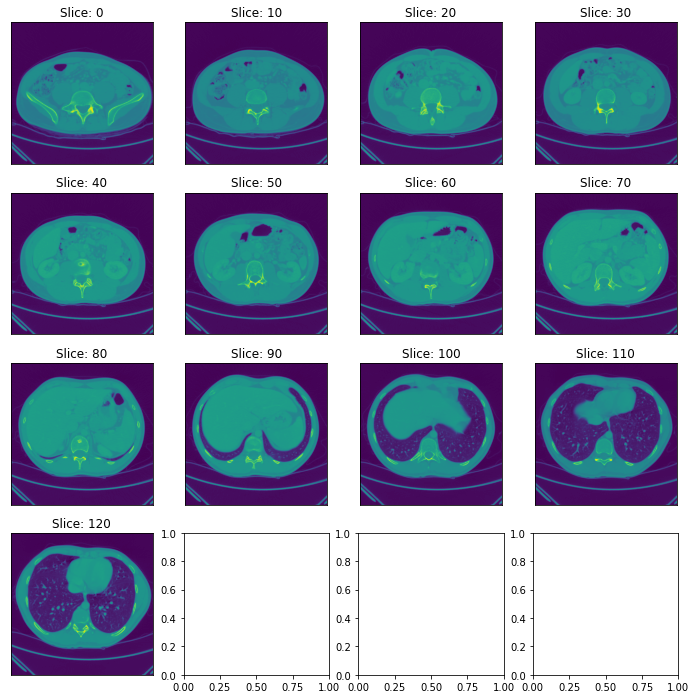

In [ ]:
import matplotlib.pyplot as plt

def show_patient(patient, figsize=(12, 12), num_slices=16, grid = (4, 4), show_every=10):
  plt.figure(figsize=figsize)
  for i in range(num_slices):
    plt.subplot(*grid, i + 1)
    try: 
      plt.imshow(patient[:,:,i * show_every])
      plt.xticks([]), plt.yticks([])
      plt.title(f'Slice: {i * show_every}')
    except:
      pass

show_patient(data[0])  

### Ground Truth

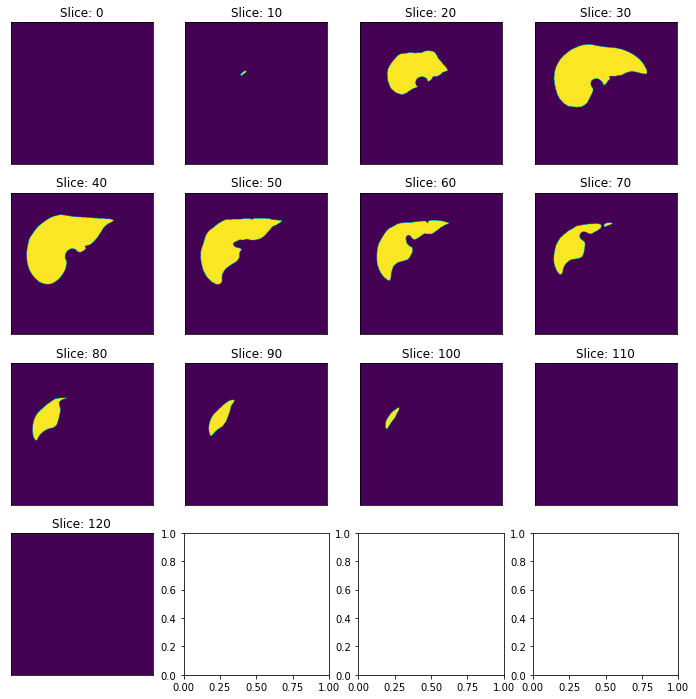

In [ ]:
show_patient(labels[0])

### MIP ground truth example

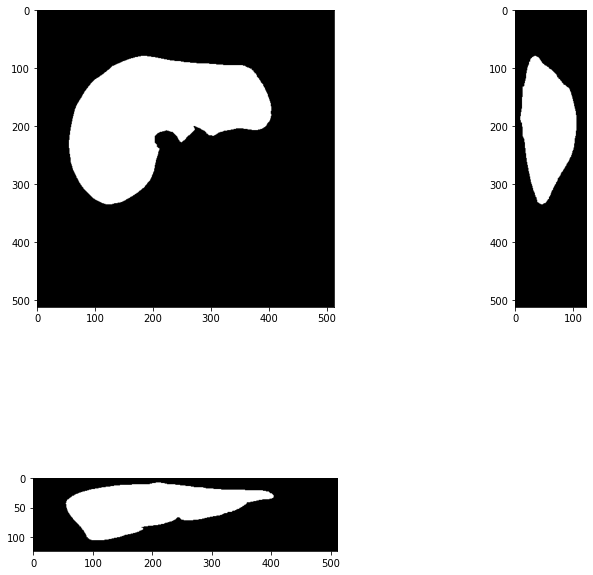

In [ ]:
labeli = labels[0].max(axis=0).transpose()
labelj = labels[0].max(axis=1)
labelk = labels[0].max(axis=2)
plt.figure(figsize=(12, 12))
plt.subplot(2, 2, 1)
# plt.title('$\mathbf{y}_{k}$')
plt.imshow(labelk, cmap='gray')
plt.subplot(2, 2, 2)
# plt.title('$\mathbf{y}_{j}$')
plt.imshow(labelj, cmap='gray')
plt.subplot(2, 2, 3)
# plt.title('$\mathbf{y}_{i}$')
plt.imshow(labeli, cmap='gray')


## Preprocessing data

In [ ]:
IMG_PX_SIZE = 128
IMG_PX_SLC = 64

In [ ]:
from skimage.transform import resize
from skimage import img_as_bool


In [ ]:
for i, (patient, label) in enumerate(zip(data, labels)):
  data[i] = resize(patient, (IMG_PX_SIZE, IMG_PX_SIZE, IMG_PX_SLC))
  labels[i] = img_as_bool(resize(label, (IMG_PX_SIZE, IMG_PX_SIZE, IMG_PX_SLC), anti_aliasing=True))

In [ ]:
data[0].shape, labels[0].shape

((128, 128, 64), (128, 128, 64))

In [ ]:
labels[0].max()

True

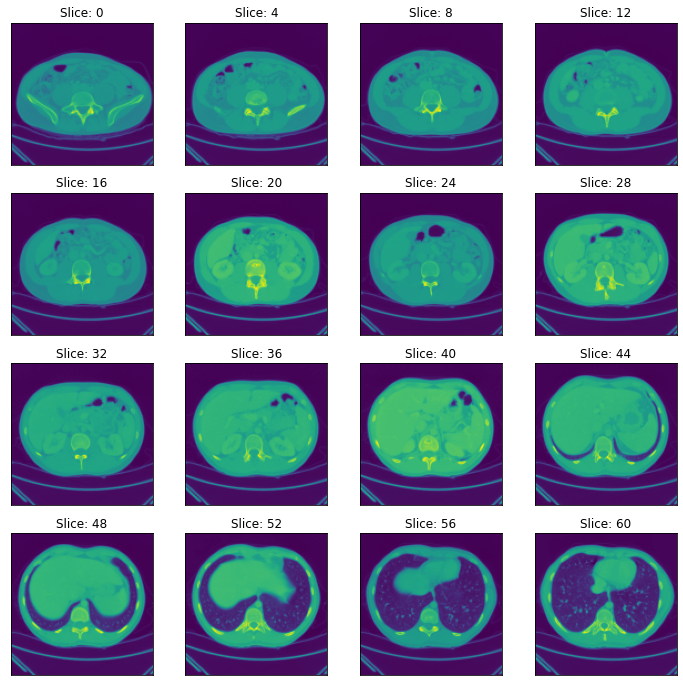

In [ ]:
show_patient(data[0], show_every=4)

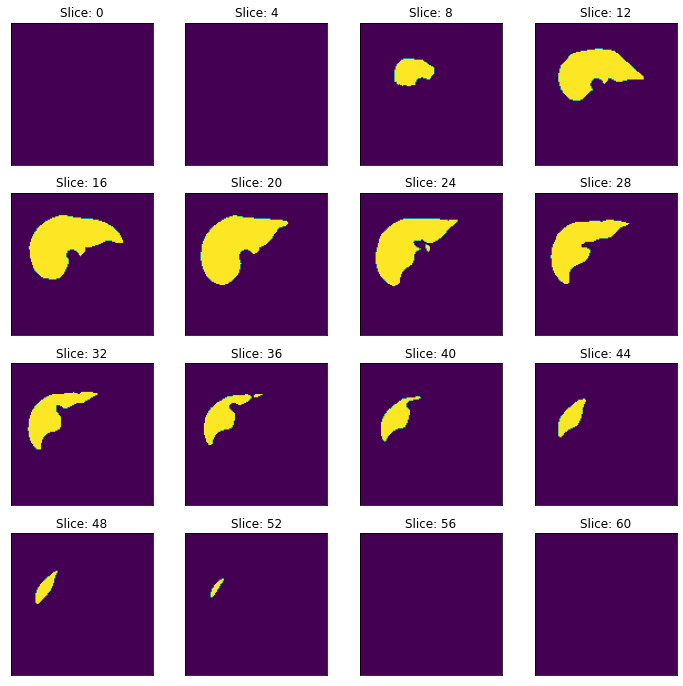

In [ ]:
show_patient(labels[0], show_every=4)

## Normalize data

In [ ]:
idx = 6
data[idx].max(), data[idx].min()

(0.03270962081330587, 0.0019884412909132523)

In [ ]:
for i, patient in enumerate(data):
  data[i] = (patient - patient.min()) / (patient.max() - patient.min())

In [ ]:
data[1].min(), data[1].max()

(0.0, 1.0)

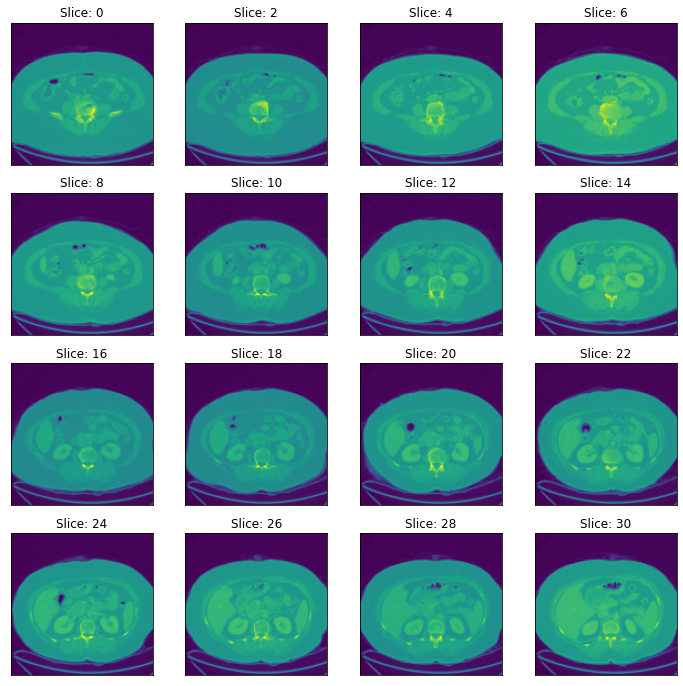

In [ ]:
show_patient(data[1], show_every=2)

## Writing preprocessed data to `npy` (Optional)

In [ ]:
import os
write_dir = f'chaos_train_ct_{IMG_PX_SIZE}x{IMG_PX_SIZE}x{IMG_PX_SLC}'
os.makedirs(write_dir)
for i, (patient, label) in enumerate(zip(data, labels)):
  np.save(f'{write_dir}/img_{i:02}.npy', patient)
  np.save(f'{write_dir}/seg_{i:02}.npy', label)

FileNotFoundError: ignored

In [ ]:
!zip -r chaos_train_ct_128x128x64.zip chaos_train_ct_128x128x64

## PyTorch dataset class

In [ ]:
from dataset import SegDataset3D

In [ ]:
trainset = SegDataset3D(data[:16], labels[:16])
valset = SegDataset3D(data[16:], labels[16:])

In [ ]:
len(trainset), len(valset)

(16, 4)

In [ ]:
trainloader = DataLoader(trainset, shuffle=False)
valloader = DataLoader(valset, shuffle=False)

In [ ]:
for x, y in valloader:
  print(x.shape, y.shape)

torch.Size([1, 1, 128, 128, 64]) torch.Size([1, 128, 128, 64])
torch.Size([1, 1, 128, 128, 64]) torch.Size([1, 128, 128, 64])
torch.Size([1, 1, 128, 128, 64]) torch.Size([1, 128, 128, 64])
torch.Size([1, 1, 128, 128, 64]) torch.Size([1, 128, 128, 64])


# U-Net 

In [ ]:
from model import UNet

In [ ]:
net = UNet(1, 2)
net = net.cuda()

In [ ]:
!rm -rf runs

In [ ]:
import torchvision
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter()

images, labels = next(iter(valloader))
image = images[0, :, :, :, ::4].transpose(3, 1).transpose(0, 1)
label = labels.transpose(0, 3).transpose(1,3)[::4]

grid_inp = torchvision.utils.make_grid(image)
grid_lab = torchvision.utils.make_grid(label)

writer.add_image('Sample input image', grid_inp, 0)
writer.add_image('Sample ground truth segmentation', grid_lab, 0)
writer.add_graph(net, images.cuda())


In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 1156), started 0:01:52 ago. (Use '!kill 1156' to kill it.)

<IPython.core.display.Javascript object>

## Training regular 3D model

In [ ]:
import torch.optim as optim

criterion = nn.CrossEntropyLoss().cuda()
optimizer = optim.Adam(net.parameters(), lr=0.0001)

In [ ]:
def dice_coeff(pred, target):
  pred = pred > 0.5
  smooth = 1.
  num = pred.size(0)
  m1 = pred.view(num, -1).float()  # Flatten
  m2 = target.view(num, -1).float()  # Flatten
  intersection = (m1 * m2).sum().float()

  return (2. * intersection + smooth) / (m1.sum() + m2.sum() + smooth)

In [ ]:
for epoch in range(100):  # loop over the dataset multiple times

    running_loss = 0.0
    running_dice = 0.0

    for i, data in enumerate(trainloader, 0):
      # get the inputs; data is a list of [inputs, labels]
      inputs, labels = data

      inputs = inputs.cuda()
      labels = labels.long().cuda()

      # zero the parameter gradients
      optimizer.zero_grad()

      # forward + backward + optimize
      outputs, yi, yj, yk = net(inputs)
      loss = criterion(outputs, labels)
      loss.backward()
      optimizer.step()

      # dice coeff
      dice = dice_coeff(outputs[:,1,:,:,:], labels)

      # print statistics
      running_loss += loss.item()
      running_dice += dice.item()

      print(f'[{epoch+1}, {i+1}] loss: {loss.item():.3} \t dice: {dice.item():.3}')
      
      
    writer.add_scalar('Loss/Training loss', running_loss/len(trainset), epoch)
    writer.add_scalar('DICE/Training dice', running_dice/len(trainset), epoch)

    with torch.no_grad():
      val_loss = 0.0
      val_dice = 0.0
      for i, data in enumerate(valloader, 0):
        inputs, labels = data

        inputs = inputs.cuda()
        labels = labels.long().cuda()
        
        outputs, yi, yj, yk = net(inputs)
        
        loss = criterion(outputs, labels)
        dice = dice_coeff(outputs[:,1,:,:,:], labels)
        
        val_loss += loss.item()
        val_dice += dice.item()

        if i == 0:
          outs = outputs[:,1,:,:,:].transpose(0, 3).transpose(1,3)[::4]
          grid_outs = torchvision.utils.make_grid(outs)
          writer.add_image('Segmentation result', grid_outs, epoch)


    print(f'[{epoch+1}] val loss: {val_loss/len(valset):.4} \t val dice: {val_dice/len(valset):.3}')
    
    writer.add_scalar('Loss/Validation loss', val_loss/len(valset), epoch)
    writer.add_scalar('DICE/Validation dice', val_dice/len(valset), epoch)
    
print('Finished Training')

[1, 1] loss: 0.771 	 dice: 0.103
[1, 2] loss: 0.75 	 dice: 0.121
[1, 3] loss: 0.674 	 dice: 0.304
[1, 4] loss: 0.663 	 dice: 0.272
[1, 5] loss: 0.604 	 dice: 0.377
[1, 6] loss: 0.572 	 dice: 0.474
[1, 7] loss: 0.573 	 dice: 0.413
[1, 8] loss: 0.594 	 dice: 0.14
[1, 9] loss: 0.543 	 dice: 0.509
[1, 10] loss: 0.54 	 dice: 0.43
[1, 11] loss: 0.533 	 dice: 0.452
[1, 12] loss: 0.53 	 dice: 0.449
[1, 13] loss: 0.511 	 dice: 0.548
[1, 14] loss: 0.527 	 dice: 0.51
[1, 15] loss: 0.513 	 dice: 0.587
[1, 16] loss: 0.525 	 dice: 0.486
[1] val loss: 0.5154 	 val dice: 0.483
[2, 1] loss: 0.521 	 dice: 0.429
[2, 2] loss: 0.518 	 dice: 0.478
[2, 3] loss: 0.499 	 dice: 0.609
[2, 4] loss: 0.517 	 dice: 0.381
[2, 5] loss: 0.501 	 dice: 0.536
[2, 6] loss: 0.495 	 dice: 0.603
[2, 7] loss: 0.501 	 dice: 0.538
[2, 8] loss: 0.537 	 dice: 0.26
[2, 9] loss: 0.487 	 dice: 0.67
[2, 10] loss: 0.498 	 dice: 0.517
[2, 11] loss: 0.487 	 dice: 0.609
[2, 12] loss: 0.495 	 dice: 0.571
[2, 13] loss: 0.482 	 dice: 0.672
[

In [ ]:
writer.close()

## Training MIP model

In [ ]:
writer = SummaryWriter()


In [ ]:
net = UNet(1, 2)
net = net.cuda()

In [ ]:
criterion = nn.CrossEntropyLoss().cuda()
optimizer = optim.Adam(net.parameters(), lr=0.0001)

In [ ]:
for epoch in range(1000):  # loop over the dataset multiple times

    running_loss = 0.0
    running_dice = 0.0

    for i, data in enumerate(trainloader, 0):
      # get the inputs; data is a list of [inputs, labels]
      inputs, labels = data

      inputs = inputs.cuda()
      labels = labels.long().cuda()
      labels_i, _ = torch.max(labels, dim=1)
      labels_j, _ = torch.max(labels, dim=2)
      labels_k, _ = torch.max(labels, dim=3)


      # zero the parameter gradients
      optimizer.zero_grad()

      # forward + backward + optimize
      outputs, yi, yj, yk = net(inputs)
      loss = criterion(yi, labels_i) + criterion(yj, labels_j) + criterion(yk, labels_k)
      loss.backward()
      optimizer.step()

      # dice coeff
      dice = dice_coeff(outputs[:,1,:,:,:], labels)

      # print statistics
      running_loss += loss.item()
      running_dice += dice.item()

      print(f'[{epoch+1}, {i+1}] loss: {loss.item():.3} \t dice: {dice.item():.3}')
      
      

    writer.add_scalar('Loss/Training loss', running_loss/len(trainset), epoch)
    writer.add_scalar('DICE/Training dice', running_dice/len(trainset), epoch)

    with torch.no_grad():
      val_loss = 0.0
      val_dice = 0.0
      for i, data in enumerate(valloader, 0):
        inputs, labels = data

        inputs = inputs.cuda()
        labels = labels.long().cuda()
        
        outputs, yi, yj, yk = net(inputs)
        
        loss = criterion(yi, labels_i) + criterion(yj, labels_j) + criterion(yk, labels_k)
        dice = dice_coeff(outputs[:,1,:,:,:], labels)
        
        val_loss += loss.item()
        val_dice += dice.item()

        if i == 0:
          outs = outputs[:,1,:,:,:].transpose(0, 3).transpose(1,3)[::4]
          grid_outs = torchvision.utils.make_grid(outs)
          writer.add_image('Segmentation result', grid_outs, epoch)

    print(f'[{epoch+1}] val loss: {val_loss/len(valset):.4} \t val dice: {val_dice/len(valset):.3}')
    
    writer.add_scalar('Loss/Validation loss', val_loss/len(valset), epoch)
    writer.add_scalar('DICE/Validation dice', val_dice/len(valset), epoch)
    
print('Finished Training')

[1, 1] loss: 2.15 	 dice: 0.0922
[1, 2] loss: 1.94 	 dice: 0.122
[1, 3] loss: 1.83 	 dice: 0.3
[1, 4] loss: 1.77 	 dice: 0.237
[1, 5] loss: 1.73 	 dice: 0.242
[1, 6] loss: 1.69 	 dice: 0.354
[1, 7] loss: 1.72 	 dice: 0.324
[1, 8] loss: 1.72 	 dice: 0.246
[1, 9] loss: 1.64 	 dice: 0.503
[1, 10] loss: 1.66 	 dice: 0.285
[1, 11] loss: 1.59 	 dice: 0.407
[1, 12] loss: 1.62 	 dice: 0.397
[1, 13] loss: 1.58 	 dice: 0.374
[1, 14] loss: 1.62 	 dice: 0.391
[1, 15] loss: 1.59 	 dice: 0.529
[1, 16] loss: 1.6 	 dice: 0.451
[1] val loss: 1.604 	 val dice: 0.459
[2, 1] loss: 1.56 	 dice: 0.388
[2, 2] loss: 1.59 	 dice: 0.346
[2, 3] loss: 1.56 	 dice: 0.572
[2, 4] loss: 1.57 	 dice: 0.334
[2, 5] loss: 1.53 	 dice: 0.461
[2, 6] loss: 1.52 	 dice: 0.59
[2, 7] loss: 1.59 	 dice: 0.509
[2, 8] loss: 1.61 	 dice: 0.291
[2, 9] loss: 1.58 	 dice: 0.635
[2, 10] loss: 1.54 	 dice: 0.44
[2, 11] loss: 1.49 	 dice: 0.569
[2, 12] loss: 1.53 	 dice: 0.523
[2, 13] loss: 1.49 	 dice: 0.495
[2, 14] loss: 1.57 	 dice: 

KeyboardInterrupt: ignored

In [ ]:
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

# References

\[1\] A.E. Kavur, M. A. Selver, O. Dicle, M. Barış,  N.S. Gezer. CHAOS - Combined (CT-MR) Healthy Abdominal Organ Segmentation Challenge Data (Version v1.03) \[Data set\]. Apr.  2019. Zenodo. http://doi.org/10.5281/zenodo.3362844

\[2\] O. Ronneberger, P. Fischer, and T. Brox. U-Net: Convolutional Networks for Biomedical Image Segmentation. In MICCAI, 2015.

\[3\] Koziński M, Mosinska A, Salzmann M, Fua P. Tracing in 2D to reduce the annotation effort for 3D deep delineation of linear structures. Medical Image Analysis. 2020 Feb;60:101590. DOI: 10.1016/j.media.2019.101590.